In [1]:
import pandas as pd

# Read in hurricane and typhoon data (1851-2014) and print column names
# Source: https://www.kaggle.com/datasets/noaa/hurricane-database

df = pd.read_csv('./atlantic.csv')
df.columns.tolist()

['ID',
 'Name',
 'Date',
 'Time',
 'Event',
 'Status',
 'Latitude',
 'Longitude',
 'Maximum Wind',
 'Minimum Pressure',
 'Low Wind NE',
 'Low Wind SE',
 'Low Wind SW',
 'Low Wind NW',
 'Moderate Wind NE',
 'Moderate Wind SE',
 'Moderate Wind SW',
 'Moderate Wind NW',
 'High Wind NE',
 'High Wind SE',
 'High Wind SW',
 'High Wind NW']

<AxesSubplot:>

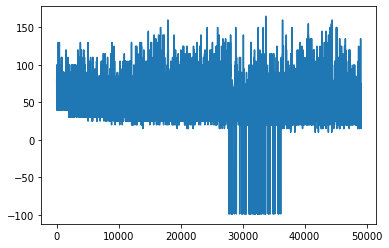

In [2]:
# A quick viz of the range of Maximum Wind values

df['Maximum Wind'].plot()

# There's actually another way -- data profiling -- to jump-start our EDA...

Be sure to uncomment/execute the cell below to install the [Pandas Profiling tool](https://github.com/ydataai/pandas-profiling)!

In [3]:
# !pip install pandas-profiling

In [4]:
# The Saffir-Simpson Hurricane Wind Scale:
# < 74 Not a hurricane
# 74 to 95 Category 1
# 96 to 110 Category 2
# 111 to 129 Category 3
# 130 to 156 Category 4
# > 156 Category 5

# Using the scale above, let's cut the observations into category bins!
# First, let's define our categories

categories = ['Category 1', 'Category 2', 'Category 3', 'Category 4', 'Category 5']

# Now, let's create a new column called "Category" and perform the requisite binning using the cut() method;
# Note that you will always pass one less label than the number of bins

df['Category'] = pd.cut(x=df['Maximum Wind'],
                        bins=[df['Maximum Wind'].min().astype('int'), 74, 95, 110, 129, 156],
                        labels = categories)

# Filter out non-hurricane data

df = df[df.Category.isin(categories)]

# Taking a peek

df.head()

,ID,Name,Date,Time,Event,Status,Latitude,Longitude,Maximum Wind,Minimum Pressure,...,Low Wind NW,Moderate Wind NE,Moderate Wind SE,Moderate Wind SW,Moderate Wind NW,High Wind NE,High Wind SE,High Wind SW,High Wind NW,Category
0,AL011851,UNNAMED,18510625,0,,HU,28.0N,94.8W,80,-999,...,-999,-999,-999,-999,-999,-999,-999,-999,-999,Category 2
1,AL011851,UNNAMED,18510625,600,,HU,28.0N,95.4W,80,-999,...,-999,-999,-999,-999,-999,-999,-999,-999,-999,Category 2
2,AL011851,UNNAMED,18510625,1200,,HU,28.0N,96.0W,80,-999,...,-999,-999,-999,-999,-999,-999,-999,-999,-999,Category 2
3,AL011851,UNNAMED,18510625,1800,,HU,28.1N,96.5W,80,-999,...,-999,-999,-999,-999,-999,-999,-999,-999,-999,Category 2
4,AL011851,UNNAMED,18510625,2100,L,HU,28.2N,96.8W,80,-999,...,-999,-999,-999,-999,-999,-999,-999,-999,-999,Category 2


In [5]:
from pandas_profiling import ProfileReport

# After importing the ProfileReport method from the imported pandas_profiling library,
# we create an object called "profile" after passing our dataframe and a report title as arguments

profile = ProfileReport(df, title="Pandas Profiling Report")

# You can then call the report inline, which results in some values being cutoff from the rendered HTML

profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
# Instead, it's often better to export the report as a stand-alone file

profile.to_file("Hurricane Data Profile Report.html")

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

###### The resulting report can really provide a quick start to your EDA workflow! 🤩